# Police Fatalities in the US From 2000 To 2020

Data obtained from Kaggle: https://www.kaggle.com/datasets/djonafegnem/police-fatalities-in-the-us-from-2000-to-2020

GitHub link: https://github.com/samantharivas/Police_Fatalities.git

## Import Libaries

In [79]:
import pandas as pd
import numpy as np
import seaborn as sns

import dmba
from dmba import regressionSummary, gainsChart, liftChart
from dmba import adjusted_r2_score, AIC_score, BIC_score

from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay, classification_report
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder
###
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
from dmba import classificationSummary
import scikitplot as skplt #####
###

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.linear_model import Perceptron

import scipy.stats as stats
from scipy.stats import chi2_contingency

import folium


import os

%matplotlib inline
import matplotlib.pylab as plt
import matplotlib 
import matplotlib.ticker as mticker

import warnings
warnings.filterwarnings("ignore") #supress warnings

## Import Dataset

In [4]:
# download datset from Kaggle
police_df = pd.read_csv('police_fatalities.csv') # read csv file 

# rename columns by replacing spaces with underscores
police_df.columns = police_df.columns.str.replace(' ', '_')

# replace single quotes with an empty string in column names
police_df.columns = police_df.columns.str.replace("'", "")

In [5]:
# print 10 random samples from the dataframe 
police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year)
27656,27616,William G. Resto,54,Male,Race unspecified,NaN,NaN,NaN,02/26/2020,Alexis Road and Whiteford Road,...,A man was wearing a mask and flashed a large k...,Pending investigation,"Intentional Use of Force, Deadly",https://nbc24.com/news/local/suspect-is-dead-f...,No,NaN,2/26/2020: A man was wearing a mask and flashe...,NaN,27616.0,2020.0
16883,19380,Samuel Freeman,23,Male,African-American/Black,African-American/Black,not imputed,NaN,12/06/2013,3100 W 28th Ave.,...,"Freeman, a 23-year-old black man, had just rob...",Justified,"Intentional Use of Force, Deadly",http://www.pbcommercial.com/article/20140204/N...,No,NaN,"12/6/2013: Freeman, a 23-year-old black man, h...",NaN,19380.0,2013.0
22372,19642,Jose Antonio Hernandez,46,Male,Hispanic/Latino,Hispanic/Latino,not imputed,https://fatalencounters.org/wp-content/uploads...,04/03/2017,Poplar St. and Woodland Circle,...,Jose Antonio Hernandez was in his underwear wh...,Justified by Solicitor,"Intentional Use of Force, Deadly",http://wspa.com/2017/04/03/officer-involved-sh...,Unknown,NaN,4/3/2017: Jose Antonio Hernandez was in his un...,NaN,19642.0,2017.0
23701,23593,Jonathan William LeRoy,39,Male,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,01/06/2018,Memorial Rd and Fishmarket Rd,...,A deputy responded to a call about a man attac...,Pending investigation,"Intentional Use of Force, Deadly",http://www.newson6.com/story/37208083/pott-cou...,No,NaN,1/6/2018: A deputy responded to a call about a...,NaN,23593.0,2018.0
2548,2025,William J. Bing,46,Male,Race unspecified,European-American/White,0.559262222,NaN,10/14/2002,645 Elaine Rd.,...,"After firing a weapon outside his house, Bing ...",Unreported,"Intentional Use of Force, Deadly",http://caselaw.findlaw.com/us-6th-circuit/1133...,Unknown,NaN,10/14/2002: After firing a weapon outside his ...,NaN,2025.0,2002.0
19157,16012,Lue Vang,39,Male,Asian/Pacific Islander,Asian/Pacific Islander,not imputed,NaN,04/22/2015,4100 Eldorado Springs Drive,...,Deputies chased an alleged kidnapper in a whit...,Justified by District Attorney,"Intentional Use of Force, Deadly",http://www.bouldercounty.org/doc/sheriff/doudy...,No,NaN,4/22/2015: Deputies chased an alleged kidnappe...,NaN,16012.0,2015.0
8024,6370,Teri Elizabeth Stanford,16,Female,European-American/White,European-American/White,0.948586619,NaN,07/23/2007,Alabama 35,...,Natasha Carter Wilson and Teri Stanford died w...,Unreported,Vehicle/Pursuit,http://www.waff.com/story/6846929/waff-48-inve...,Unknown,NaN,7/23/2007: Natasha Carter Wilson and Teri Stan...,NaN,6370.0,2007.0
2898,2312,Derrick Lamar Jenkins,34,Male,African-American/Black,African-American/Black,not imputed,NaN,02/18/2003,55th St. and Holmes Ave.,...,Officers Mark Griego and Luis Calzadillas shot...,Unreported,"Intentional Use of Force, Deadly",http://www.lapdonline.org/february_2003/news_v...,Unknown,NaN,2/18/2003: Officers Mark Griego and Luis Calza...,NaN,2312.0,2003.0
6213,4952,Guillermo Davila,71,Male,Hispanic/Latino,Hispanic/Latino,not imputed,http://archive.news10.net/images/640/360/2/ass...,03/05/2006,999 W Mathews Rd.,...,"Guillermo Davila, who suffered from Alzheimer'...",Unreported,No,http://www.recordnet.com/article/20060327/NEWS...,Yes,NaN,"3/5/2006: Guillermo Davila, who suffered from ...",NaN,4952.0,2006.0
8170,6496,Edward John Cavaliere,68,Male,Race unspecified,European-American

## Data Inspection

In [6]:
police_df.shape

(28335, 29)

In [7]:
police_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27354 non-null  object 
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          27897 non-null  object 
 7   URL_of_image_of_deceased                         

In [8]:
# convert coolumns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude','Location_of_death_(zip_code)', 
                      'Imputation_probability','Unique_identifier_(redundant)', 'Date_(Year)']

for col in columns_to_convert:
    police_df[col] = pd.to_numeric(police_df[col], errors='coerce')
    
police_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27294 non-null  float64
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          7029 non-null   float64
 7   URL_of_image_of_deceased                         

In [9]:
# convert the date column to a datetime format
police_df['Date_of_injury_resulting_in_death'] = pd.to_datetime(police_df['Date_of_injury_resulting_in_death_(month/day/year)'])

# extract month, day, and year into separate columns
police_df['Injury_Month'] = police_df['Date_of_injury_resulting_in_death'].dt.month
police_df['Injury_Day'] = police_df['Date_of_injury_resulting_in_death'].dt.day
police_df['Injury_Year'] = police_df['Date_of_injury_resulting_in_death'].dt.year

police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
2840,2266,Dewayne Davenport,25.0,Male,African-American/Black,African-American/Black,NaN,NaN,01/28/2003,113 S Pannes Ave,...,Unknown,NaN,"1/28/2003: Dewayne Davenport, a 25-year-old bl...",NaN,2266.0,2003.0,2003-01-28,1,28,2003
15926,12864,Joseph Moreno,24.0,Male,Hispanic/Latino,Hispanic/Latino,NaN,http://kpho.images.worldnow.com/images/2249264...,05/30/2013,S Country Club Dr & Broadway Access Rd,...,Drug or alcohol use,NaN,"5/30/2013: Wanted for parole violation, for a ...",NaN,12864.0,2013.0,2013-05-30,5,30,2013
19351,16199,Miguel Martinez,18.0,Male,Hispanic/Latino,Hispanic/Latino,NaN,http://www.gannett-cdn.com/-mm-/154ef28f15788e...,06/03/2015,Interstate 35E,...,Yes,NaN,6/3/2015: Miguel Martinez stole a police SUV f...,NaN,16199.0,2015.0,2015-06-03,6,3,2015
12694,10078,Charles Odell Smith,20.0,Male,African-American/Black,African-American/Black,NaN,NaN,04/16/2011,13700 block Hotomtot Drive,...,Yes,NaN,4/16/2011: Police had been called by the man's...,NaN,10078.0,2011.0,2011-04-16,4,16,2011
20168,16950,Tuan Hoang,NaN,Male,Asian/Pacific Islander,Asian/Pacific Islander,NaN,http://i.dailymail.co.uk/i/pix/2015/12/04/16/2...,11/30/2015,E Alameda Pkwy and E Kentucky Ave,...,No,NaN,11/30/2015: Police have shot dead Tuan Huong a...,NaN,16950.0,2015.0,2015-11-30,11,30,2015
6462,5135,Donald Lee Hobrecht,47.0,Male,European-American/White,European-American/White,NaN,NaN,05/19/2006,2503 Flowery Trail Road,...,Yes,NaN,5/19/2006: Hobrecht had come to his neighbor's...,NaN,5135.0,2006.0,2006-05-19,5,19,2006
7586,6015,Donald Perry,49.0,Male,Race unspecified,African-American/Black,0.980533,NaN,03/29/2007,1200 block Sistrunk Boulevard,...,Drug or alcohol use,NaN,3/29/2007: Perry was struck by a speeding unma...,NaN,6015.0,2007.0,2007-03-29,3,29,2007
23163,22320,Michael Culhane,50.0,Male,European-American/White,European-American/White,NaN,NaN,09/08/2017,400 block North Central Avenue,...,Drug or alcohol use,NaN,9/8/2017: Police officers responded to an over...,NaN,22320.0,2017.0,2017-09-08,9,8,2017
18307,15192,Armondo Ochoa,36.0,Male,Hispanic/Latino,Hispanic/Latino,NaN,NaN,10/07/2014,5900 Bonhomme Rd,...,No,NaN,10/7/2014: Ochoa kidnapped his estranged wife....,NaN,15192.0,2014.0,2014-10-07,10,7,2014
25111,11466,Phillip Samuel Moskios Jr.,48.0,Male,European-American/White,European-American/White,NaN,NaN,10/05/2018,27110-26684 US-97,...,No,NaN,10/5/2018: Police shot and killed Phillip Samu...,NaN,11466.0,2018.0,2018-10-05,10,5,2018


In [10]:
police_df.columns #column names within the df 

Index(['Unique_ID', 'Subjects_name', 'Subjects_age', 'Subjects_gender',
       'Subjects_race', 'Subjects_race_with_imputations',
       'Imputation_probability', 'URL_of_image_of_deceased',
       'Date_of_injury_resulting_in_death_(month/day/year)',
       'Location_of_injury_(address)', 'Location_of_death_(city)',
       'Location_of_death_(state)', 'Location_of_death_(zip_code)',
       'Location_of_death_(county)', 'Full_Address', 'Latitude', 'Longitude',
       'Agency_responsible_for_death', 'Cause_of_death',
       'A_brief_description_of_the_circumstances_surrounding_the_death',
       'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',
       'Intentional_Use_of_Force_(Developing)',
       'Link_to_news_article_or_photo_of_official_document',
       'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Video',
       'Date&Description', 'Unique_ID_formula',
       'Unique_identifier_(redundant)', 'Date_(Year)',
       'Date_of_injury_resulting_in_death', 'Injur

In [11]:
police_df.nunique() #number of unique values within each column 

Unique_ID                                                         28334
Subjects_name                                                     26982
Subjects_age                                                         97
Subjects_gender                                                       3
Subjects_race                                                         8
Subjects_race_with_imputations                                        9
Imputation_probability                                             6954
URL_of_image_of_deceased                                          12857
Date_of_injury_resulting_in_death_(month/day/year)                 7182
Location_of_injury_(address)                                      26026
Location_of_death_(city)                                           5940
Location_of_death_(state)                                            51
Location_of_death_(zip_code)                                      10460
Location_of_death_(county)                                      

In [12]:
police_df.kurtosis() # shape of distribution of numeric columns 

Subjects_age                     0.528233
Imputation_probability           0.079034
Location_of_death_(zip_code)    -1.272116
Latitude                         1.737740
Longitude                       -0.157605
Unique_ID_formula                     NaN
Unique_identifier_(redundant)   -1.200000
Date_(Year)                      0.842675
Injury_Month                    -1.167422
Injury_Day                      -1.192541
Injury_Year                      0.836232
dtype: float64

## Exploratory Data Analysis

### Handling Missing Data 

In [13]:
#identify missing values in each column 
police_df.isnull().sum()  

Unique_ID                                                             1
Subjects_name                                                         0
Subjects_age                                                       1041
Subjects_gender                                                      98
Subjects_race                                                         1
Subjects_race_with_imputations                                      430
Imputation_probability                                            21306
URL_of_image_of_deceased                                          15424
Date_of_injury_resulting_in_death_(month/day/year)                    0
Location_of_injury_(address)                                        542
Location_of_death_(city)                                             36
Location_of_death_(state)                                             1
Location_of_death_(zip_code)                                        190
Location_of_death_(county)                                      

In [14]:
# calculate missing values as a percentage of total data 
missing_percentage = (police_df.isnull().sum() / len(police_df)) * 100
missing_percentage = missing_percentage.sort_values(ascending=False)

print('Missing Value Percentage per Column:')
print(missing_percentage)

Missing Value Percentage per Column:
Unique_ID_formula                                                 99.992942
Video                                                             99.989412
Imputation_probability                                            75.193224
URL_of_image_of_deceased                                          54.434445
Subjects_age                                                       3.673902
Location_of_injury_(address)                                       1.912829
Subjects_race_with_imputations                                     1.517558
Location_of_death_(zip_code)                                       0.670549
Subjects_gender                                                    0.345862
Agency_responsible_for_death                                       0.243515
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS         0.218811
Location_of_death_(city)                                           0.127051
Date&Description                                   

The columns which have a majority of their rows missing (50% and above), to maintain the integrity of the data, they will be dropped instead of imputed.

In [15]:
# drop columns where more than 50% of the data is missing 

# identify columns with more than 50% missing values
columns = missing_percentage[missing_percentage > 50]
columns_to_drop = missing_percentage[missing_percentage > 50].index

print('Columns with More than 50% Missing Values:')
print(columns)

Columns with More than 50% Missing Values:
Unique_ID_formula           99.992942
Video                       99.989412
Imputation_probability      75.193224
URL_of_image_of_deceased    54.434445
dtype: float64


In [16]:
# drop the identified columns from the DataFrame
police_df.drop(columns=columns_to_drop, inplace=True)

Remaining of the missing values will be filled with the 'most frequent' value using a SimpleImputer.

In [17]:
# use SimpleImputer to replace the NaN values with the 'most frequent value '
imp = SimpleImputer(strategy = 'most_frequent')

In [18]:
# fit and transform the data replacing the NaN values of each feature with the
# 'most frequent' value of each feature
imputed_df = imp.fit_transform(police_df)

In [19]:
# obtain column names from original df
column_names = police_df.columns

# create a df from the imputed_data array
imputed_df = pd.DataFrame(imputed_df, columns=column_names)

imputed_df.head()

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),...,Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Date&Description,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
0,25746,Samuel H. Knapp,17.0,Male,European-American/White,European-American/White,01/01/2000,27898-27804 US-101,Willits,CA,...,Vehicle/Pursuit,https://drive.google.com/file/d/10DisrV8K5ReP1...,No,1/1/2000: Samuel Knapp was allegedly driving a...,25746.0,2000.0,2000-01-01,1,1,2000
1,25747,Mark A. Horton,21.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25747.0,2000.0,2000-01-01,1,1,2000
2,25748,Phillip A. Blurbridge,19.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25748.0,2000.0,2000-01-01,1,1,2000
3,25749,Mark Ortiz,23.0,Male,Hispanic/Latino,Hispanic/Latino,01/01/2000,600 W Cherry Ln,Carlsbad,NM,...,Vehicle/Pursuit,https://drive.google.com/file/d/1qAEefRjX_aTtC...,No,1/1/2000: A motorcycle was allegedly being dri...,25749.0,2000.0,2000-01-01,1,1,2000
4,2,Lester Miller,53.0,Male,Race unspecified,African-American/Black,01/02/2000,4850 Flakes Mill Road,Ellenwood,GA,...,"Intentional Use of Force, Deadly",https://docs.google.com/document/d/1-YuShSarW_...,No,"1/2/2000: Darren Mayfield, a DeKalb County she...",2.0,2000.0,2000-01-02,1,2,2000


### Removing Duplicate Values

In [20]:
# identify number of duplicates in the df  
duplicates = imputed_df.duplicated()

# display rows with duplicates
duplicates = imputed_df.duplicated()
count_duplicates = duplicates.sum()
print("Count of Duplicate Rows:", count_duplicates)

Count of Duplicate Rows: 0


Data frame has zero duplicate values, thus all values remain. 

### Dropping Columns 

In [21]:
# drop redudant columns that will not be used for modeling 

imputed_df.drop(columns=['Unique_identifier_(redundant)', 'Link_to_news_article_or_photo_of_official_document', 
                        'Subjects_race_with_imputations', 'Subjects_name', 'Date&Description', 
                        'Full_Address', 'Date_(Year)', 'Date_of_injury_resulting_in_death', 'Injury_Day', 
                        'Date_of_injury_resulting_in_death_(month/day/year)'],inplace=True)

imputed_df.head()

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),Location_of_death_(zip_code),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
0,25746,17.0,Male,European-American/White,27898-27804 US-101,Willits,CA,95490.0,Mendocino,39.470883,-123.361751,Mendocino County Sheriff's Office,Vehicle,Samuel Knapp was allegedly driving a stolen ve...,Unreported,Vehicle/Pursuit,No,1,2000
1,25747,21.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
2,25748,19.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
3,25749,23.0,Male,Hispanic/Latino,600 W Cherry Ln,Carlsbad,NM,88220.0,Eddy,32.45008,-104.237643,Eddy County Sheriff's Office,Vehicle,A motorcycle was allegedly being driven errati...,Unreported,Vehicle/Pursuit,No,1,2000
4,2,53.0,Male,Race unspecified,4850 Flakes Mill Road,Ellenwood,GA,30294.0,DeKalb,33.645164,-84.229413,DeKalb County Sheriff's Office,Gunshot,"Darren Mayfield, a DeKalb County sheriff's dep...",Criminal,"Intentional Use of Force, Deadly",No,1,2000


## Data Visualizations


#### Map Visualizations - Subset Dataset to California 

In [22]:
# create United States map with incidents based on longitude and latitude values - sorted by gender 

# calculate the average latitude and longitude values 
average_latitude = imputed_df['Latitude'].mean()
average_longitude = imputed_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


us_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=3)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in imputed_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(us_map)

# display map
us_map

In [23]:
# create subset for California data 
ca_df = imputed_df[imputed_df['Location_of_death_(state)'] == 'CA']

#drop location by state and zip code
ca_df = ca_df.drop(columns=['Location_of_death_(state)', 'Location_of_death_(zip_code)'])

ca_df.sample(10)

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
928,720,33.0,Male,Race unspecified,Larch Lane and East Cliff Dr.,Capitola,Santa Cruz,36.959585,-121.965749,"Capitola Police Department, Santa Cruz Police ...",Gunshot,Ronald Larez reportedly killed himself while f...,Suicide,Suicide,Unknown,1,2001
21483,25159,41.0,Male,European-American/White,11000 block Golden State Highway,Dairyville,Tehama,40.113881,-122.117008,Tehama County Sheriff's Office,Tasered,Harry Velez called 911 after he thought he had...,Unreported,Yes,Yes,9,2016
141,92,40.0,Male,Race unspecified,888 Higate Drive,Daly City,San Mateo,37.670621,-122.485172,Daly City Police Department,Gunshot,Officers Ron Harrison and Jeff Rodriguez shot ...,Unknown,"Intentional Use of Force, Deadly",Unknown,2,2000
15747,12695,36.0,Male,European-American/White,7900 Garden Grove Boulevard,Garden Grove,Orange,33.773153,-117.994248,Garden Grove Police Department,Gunshot,Chad Lee Hanchett died from injuries sustained...,Justified,"Intentional Use of Force, Deadly",Unknown,4,2013
6811,5407,33.0,Male,Race unspecified,11601 Fair Oaks Blvd,Fair Oaks,Sacramento,38.663164,-121.262168,Sacramento County Sheriff's Office,Gunshot,A deputy shot and killed Michael Douglas Riley...,Unreported,"Intentional Use of Force, Deadly",Yes,8,2006
14341,11453,27.0,Male,Race unspecified,E Clinton Ave. and N Orchard St.,Fresno,Fresno,36.772296,-119.774822,Fresno Police Department,Gunshot,A wanted parolee was shot by Fresno police aft...,Justified,"Intentional Use of Force, Deadly",No,6,2012
11623,9226,32.0,Male,Hispanic/Latino,513 Emmett Williams Way,Montebello,Los Angeles,34.010643,-118.105427,Montebello Police Department,Gunshot,Garcia confronted officers with a knife and re...,Unreported,"Intentional Use of Force, Deadly",No,6,2010
16232,13162,34.0,Male,European-American/White,3800 S Reino Rd,Newbury Park,Ventura,34.161841,-118.956946,California Highway Patrol,Vehicle,Larry Jason Wright was killed when his motorcy...,Unreported,Vehicle/Pursuit,No,7,2013
27260,27221,28.0,Female,European-American/White,Oakdale Road and Scenic Drive,Modesto,Stanislaus,37.653063,-120.957408,Ceres Police Department,Vehicle,Around 1:30 a.m. an officer attempted to talk ...,Criminal,Vehicle/Pursuit,No,12,2019
4672,3740,40.0,Male,Race unspecified,Meadow Grove Court,Bakersfield,Kern,35.432799,-119.033499,Kern County Sheriff's Office,Gunshot,Deputies shot and killed James Alan Walters wh...,Cleared,"Intentional Use of Force, Deadly",Unknown,11,2004


In [24]:
# convert coolumns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year', 'Injury_Month']

for col in columns_to_convert:
    ca_df[col] = pd.to_numeric(ca_df[col], errors='coerce')
    
ca_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4549 entries, 0 to 28334
Data columns (total 17 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       4549 non-null   object 
 1   Subjects_age                                                    4549 non-null   float64
 2   Subjects_gender                                                 4549 non-null   object 
 3   Subjects_race                                                   4549 non-null   object 
 4   Location_of_injury_(address)                                    4549 non-null   object 
 5   Location_of_death_(city)                                        4549 non-null   object 
 6   Location_of_death_(county)                                      4549 non-null   object 
 7   Latitude                                          

In [25]:
# create a map of califronia incidents to find outliers 

# calculate the average latitude and longitude values 
average_latitude = ca_df['Latitude'].mean()
average_longitude = ca_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


ca_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=5)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in ca_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(ca_map)

# display map
ca_map

From the map we can identify outliers within longitude and latitude, these will be removed from the dataframe.

#### Pair Plot

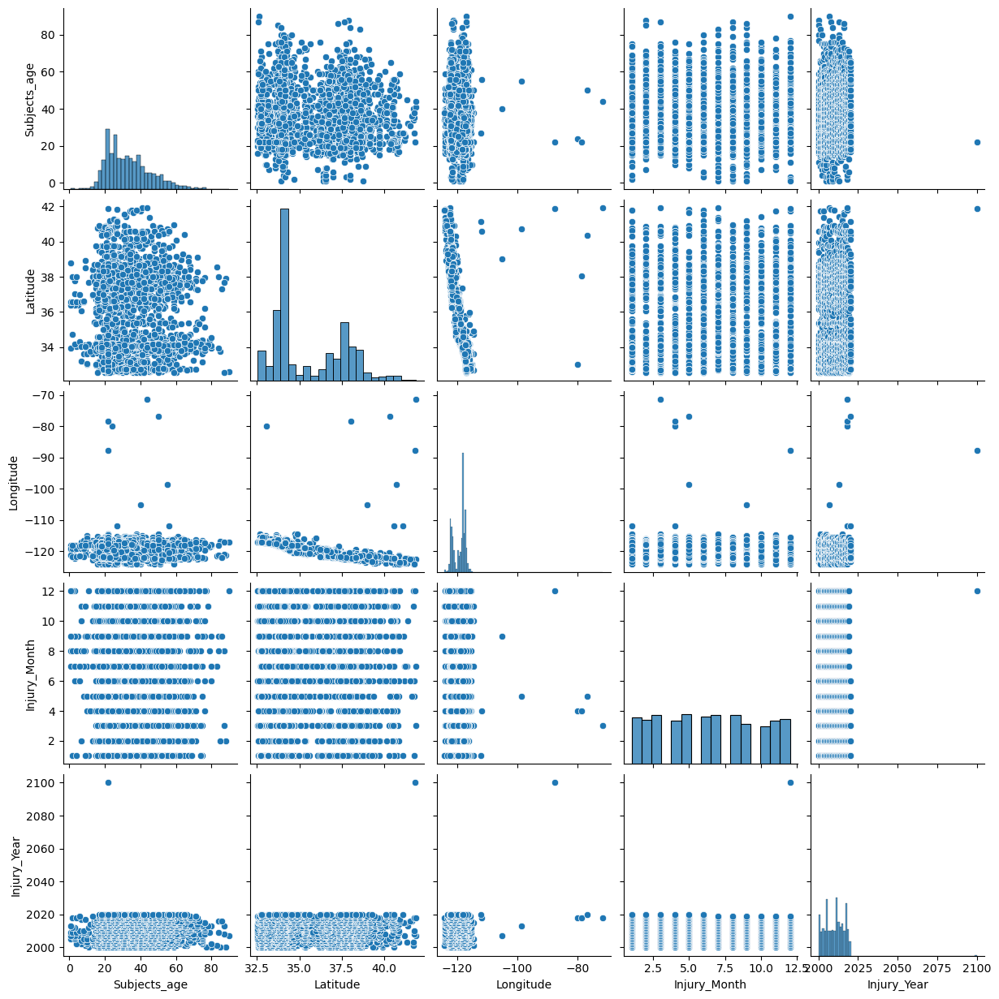

In [26]:
# reset the index to remove any duplicate labels
ca_df.reset_index(drop=True, inplace=True)

# create a pair plot
sns.pairplot(ca_df)
plt.show()

#### Box Plots

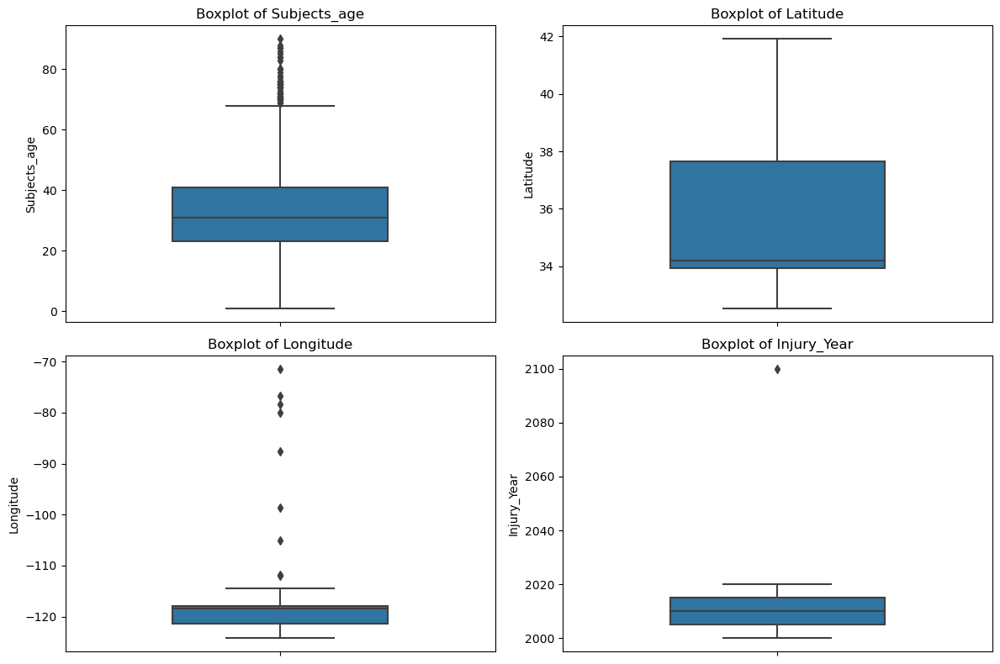

In [27]:
# List of numerical predictors
predictors = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']

# create boxplots 
plt.figure(figsize=(12, 8))  

for i, predictor in enumerate(predictors):
    plt.subplot(2, 2, i + 1)  
    sns.boxplot(data=ca_df, y=predictor, width=0.5)
    plt.title(f'Boxplot of {predictor}')
    plt.ylabel(predictor)

plt.tight_layout()  
plt.show()

The column 'Injury_Year' appears to have an outlier, the column will be reflected to only show data collected form 2000-2020. 

#### Bar Plots

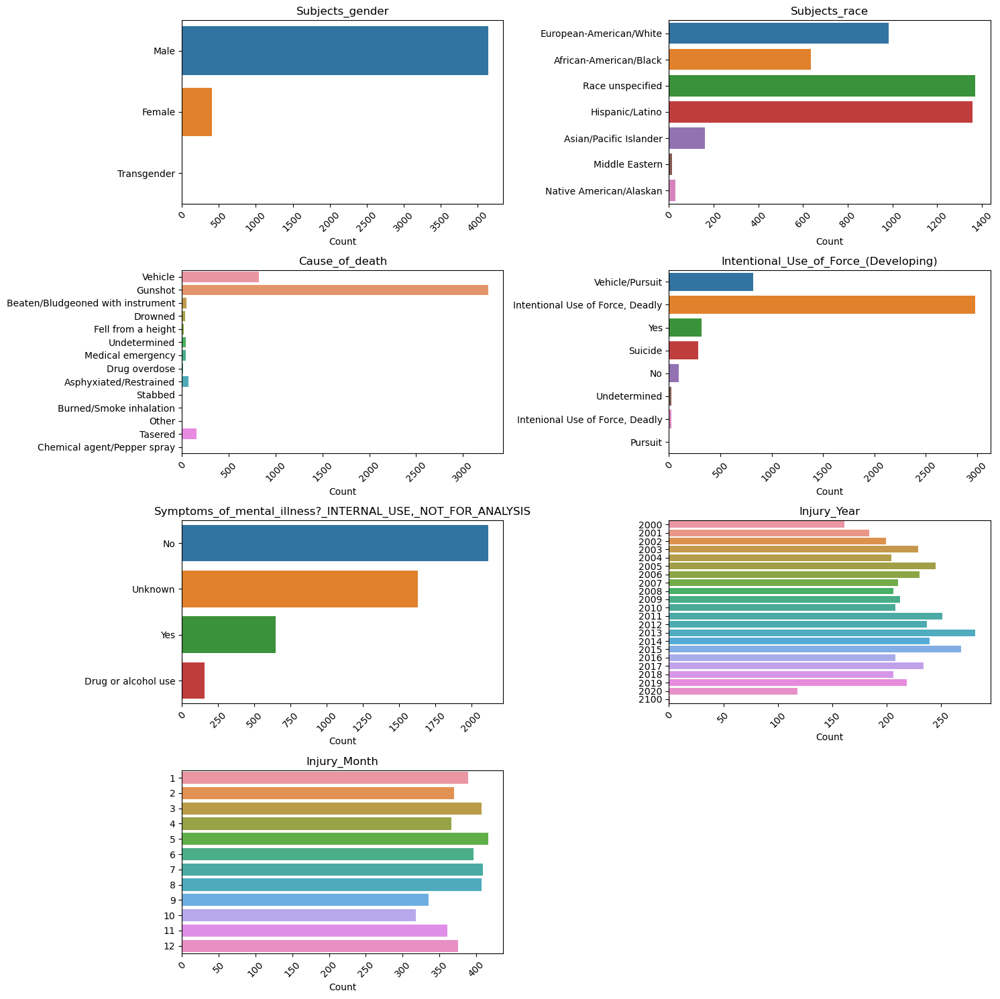

In [28]:
# list of selected columnsfor bar plot 
selected_columns =['Subjects_gender', 'Subjects_race', 'Cause_of_death', 'Intentional_Use_of_Force_(Developing)',
                   'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Injury_Year', 'Injury_Month']

# calculate the number of rows and columns for the subplot grid
num_cols = 2
num_rows = (len(selected_columns) - 1) // num_cols + 1

# create subplots and flatten axis
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()

# iterate through selected columns and create horizontal countplots
for i, column in enumerate(selected_columns):
    sns.countplot(data=ca_df, y=column, ax=axes[i])
    axes[i].tick_params(axis='x', rotation=45)  

    axes[i].set_title(f'{column}')
    axes[i].set_xlabel('Count')
    axes[i].set_ylabel('')

# remove empty subplots
for i in range(len(selected_columns), num_rows * num_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

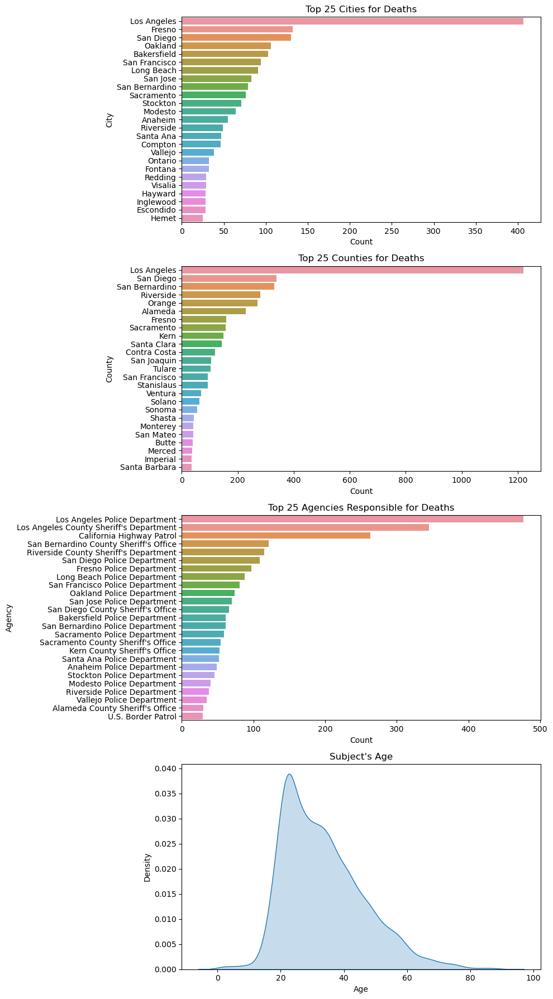

In [29]:
# create figure with subplots
fig, axes = plt.subplots(4, 1, figsize=(10, 18))

# first suplot - top 25 cities for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(city)', 
              order=ca_df['Location_of_death_(city)'].value_counts().index[:25], ax=axes[0])
axes[0].set_xlabel('Count')
axes[0].set_ylabel('City')
axes[0].set_title('Top 25 Cities for Deaths')


# second subplot - top 25 counties for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(county)', 
              order=ca_df['Location_of_death_(county)'].value_counts().index[:25], ax=axes[1])
axes[1].set_xlabel('Count')
axes[1].set_ylabel('County')
axes[1].set_title('Top 25 Counties for Deaths')

# third suplot - top 25 agencies responsible for deaths 
sns.countplot(data=ca_df, y='Agency_responsible_for_death', 
              order=ca_df['Agency_responsible_for_death'].value_counts().index[:25], ax=axes[2])
axes[2].set_xlabel('Count')
axes[2].set_ylabel('Agency')
axes[2].set_title('Top 25 Agencies Responsible for Deaths')


# fourth suplot - subjects age 
sns.kdeplot(data=ca_df, x='Subjects_age', fill=True, ax=axes[3])
axes[3].set_xlabel('Age')
axes[3].set_ylabel('Density')
axes[3].set_title('Subject\'s Age')


# Adjust subplot spacing
plt.tight_layout()

# Show the combined plot
plt.show()

#### Line Plot (Trend of Deaths)

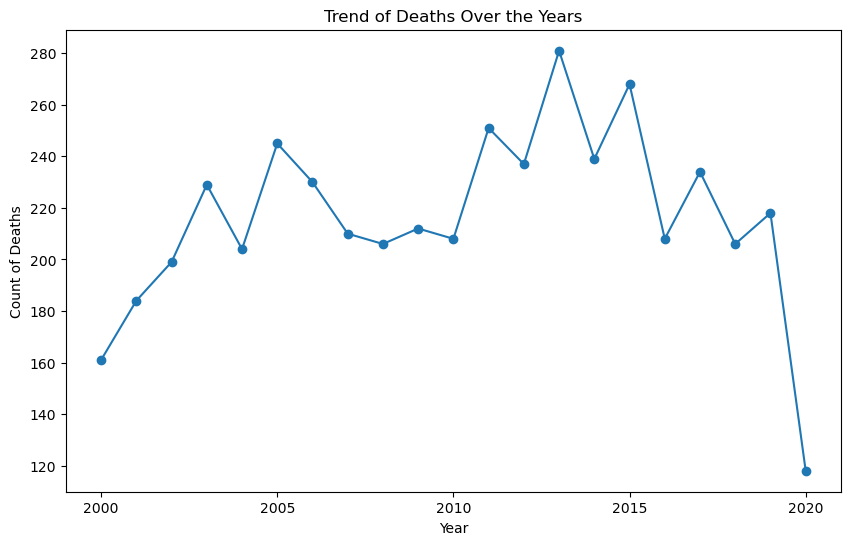

In [30]:
# per boxplot, the years will be filtered to 2000-2020 
ca_df = ca_df[(ca_df['Injury_Year'] >= 2000) & (ca_df['Injury_Year'] <= 2020)]

yearly_deaths = ca_df['Injury_Year'].value_counts().sort_index()

# create a line plot for the trend
plt.figure(figsize=(10, 6))
plt.plot(yearly_deaths.index, yearly_deaths.values, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Count of Deaths')
plt.title('Trend of Deaths Over the Years')

# set x-axis ticks to display every 5 years from 2000 to 2020
plt.xticks(range(2000, 2021, 5))


plt.grid(False)
plt.show()

### Removing Outliers 

In [31]:
# removing outliers from 'longitude' and 'latitude' 

# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Latitude'].quantile(0.25)
Q3_latitude = ca_df['Latitude'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude

Q1_longitude = ca_df['Longitude'].quantile(0.25)
Q3_longitude = ca_df['Longitude'].quantile(0.75)
IQR_longitude = Q3_longitude - Q1_longitude

# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

longitude_lower_bound = Q1_longitude - 1.5 * IQR_longitude
longitude_upper_bound = Q3_longitude + 1.5 * IQR_longitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Latitude'] >= latitude_lower_bound) &
    (ca_df['Latitude'] <= latitude_upper_bound) &
    (ca_df['Longitude'] >= longitude_lower_bound) &
    (ca_df['Longitude'] <= longitude_upper_bound)
]

In [32]:
# removing outliers from 'subjects_age'
ca_df['Subjects_age'].unique()

array([17., 24., 31., 28., 41., 25., 26., 22., 35., 20., 88., 40., 85.,
       42., 50., 43., 27., 29., 46., 59., 51., 36., 18., 23., 38., 44.,
       34., 33., 39., 30., 37., 45., 16., 47., 53., 55., 54., 19., 80.,
       11., 32., 52., 48., 21., 77., 14., 66., 15., 60., 56., 58., 83.,
        9., 65., 57.,  7., 62., 10., 49.,  4., 75., 67., 63., 69., 74.,
       70., 68., 61., 13.,  8.,  1., 72.,  3., 71., 64.,  5., 90., 87.,
       76.,  2., 79., 84.,  6., 78., 12., 86., 73.])

In [33]:
# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Subjects_age'].quantile(0.25)
Q3_latitude = ca_df['Subjects_age'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude


# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Subjects_age'] >= latitude_lower_bound) &
    (ca_df['Subjects_age'] <= latitude_upper_bound)] 

### Contigency Tables

In [34]:
# define target column 
target_column = 'Cause_of_death'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,59124.000000,4.841482e-01,59111
1,Subjects_age,1710.108426,1.275170e-27,1118
2,Subjects_gender,499.696272,4.030832e-89,26
3,Subjects_race,191.762870,1.449316e-11,78
4,Location_of_injury_(address),55884.447874,4.379805e-02,55315
5,Location_of_death_(city),10834.579335,1.137971e-32,9139
6,Location_of_death_(county),1283.730930,1.245392e-36,702
7,Latitude,57265.138598,4.869947e-08,55471
8,Longitude,57265.138598,3.929518e-08,55458
9,Agency_responsible_for_death,9231.163126,2.482851e-39,7514


In [35]:
# define target column 
target_column = 'Intentional_Use_of_Force_(Developing)'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,31836.000000,4.878803e-01,31829
1,Subjects_age,973.562079,5.252351e-20,602
2,Subjects_gender,434.081105,8.213261e-84,14
3,Subjects_race,342.647123,8.687141e-49,42
4,Location_of_injury_(address),30890.816069,3.757128e-06,29785
5,Location_of_death_(city),7257.715397,1.040673e-94,4921
6,Location_of_death_(county),615.277636,1.318081e-13,378
7,Latitude,31376.689052,6.376562e-10,29869
8,Longitude,31376.689052,5.340616e-10,29862
9,Agency_responsible_for_death,7248.872701,7.372474e-186,4046


In [36]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Cause_of_death'
contingency_force = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df ['Cause_of_death'])

contingency_force

Cause_of_death,Asphyxiated/Restrained,Beaten/Bludgeoned with instrument,Burned/Smoke inhalation,Chemical agent/Pepper spray,Drowned,Drug overdose,Fell from a height,Gunshot,Medical emergency,Other,Stabbed,Tasered,Undetermined,Vehicle
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,21,0,0,0,0,0,0
"Intentional Use of Force, Deadly",0,0,0,0,0,0,0,2977,0,1,1,0,0,0
No,0,1,0,0,35,12,13,0,29,0,2,0,3,0
Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,4
Suicide,1,0,1,0,1,1,7,269,0,1,2,2,0,1
Undetermined,0,0,0,0,0,1,0,0,1,0,0,0,23,0
Vehicle/Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,820
Yes,72,49,4,7,0,0,1,0,12,4,0,155,14,0


In [37]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_disposition = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_disposition

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,19,0
"Intentional Use of Force, Deadly",2,2,2,6,1,0,53,19,1,0,...,740,1,1,0,0,1,0,162,1252,3
No,9,1,0,0,0,0,7,1,0,0,...,12,0,0,1,0,0,0,6,53,2
Pursuit,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,2,0
Suicide,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,67,0,219,0,0,0
Undetermined,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,23,0
Vehicle/Pursuit,8,1,0,1,0,1,31,62,0,0,...,88,0,0,1,0,0,0,53,565,0
Yes,12,0,0,1,1,1,57,2,0,1,...,61,0,0,1,0,0,0,13,134,0


In [38]:
# create contigency table for 'Cause_of_death' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_death = pd.crosstab(ca_df['Cause_of_death'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_death

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Cause_of_death,,,,,,,,,,,,,,,,,,,,,
Asphyxiated/Restrained,4,0,0,0,0,0,17,0,0,0,...,15,0,0,0,0,0,1,4,26,0
Beaten/Bludgeoned with instrument,2,0,0,0,0,1,7,1,0,0,...,9,0,0,0,0,0,0,5,17,0
Burned/Smoke inhalation,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,3,0
Chemical agent/Pepper spray,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,5,0
Drowned,3,0,0,0,0,0,0,0,0,0,...,6,0,0,0,0,0,1,3,23,0
Drug overdose,4,1,0,0,0,0,2,0,0,0,...,0,0,0,0,0,0,1,1,4,0
Fell from a height,1,0,0,0,0,0,1,0,0,0,...,1,0,0,0,2,0,5,2,9,0
Gunshot,2,2,2,5,1,0,53,19,1,0,...,740,1,1,0,64,1,205,163,1271,3
Medical emergency,1,0,0,0,0,0,3,0,0,0,...,11,0,0,1,0,0,0,0,21,2


### ANOVA (Cause of Death and Numerical Values)

In [39]:
# ANOVA between numberical variables and Cause of Death 

for predictor in ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']:
    grouped_data = [ca_df[predictor][ca_df['Cause_of_death'] == category] for category in ca_df['Cause_of_death'].unique()]
    f_statistic, p_value = stats.f_oneway(*grouped_data)
    print(f'{predictor} vs. Cause of Death:')
    print(f'F-statistic: {f_statistic}')
    print(f'P-value: {p_value}\n')

Subjects_age vs. Cause of Death:
F-statistic: 5.728529438692074
P-value: 1.4891504337475343e-10

Latitude vs. Cause of Death:
F-statistic: 3.7049401522931693
P-value: 6.624725458629456e-06

Longitude vs. Cause of Death:
F-statistic: 2.0464365900729953
P-value: 0.014292850594702793

Injury_Year vs. Cause of Death:
F-statistic: 5.123165376161279
P-value: 3.993013836667257e-09



### Text Analysis (brief description column)

In [40]:
corpus = ca_df['A_brief_description_of_the_circumstances_surrounding_the_death']

corpus.tail()

4543    Reports of a robbery at C.V. Guns & Tackle cam...
4544    About 1 a.m., deputies responded to a burglary...
4545    Around 9:30 a.m., deputies responded to a susp...
4546    Border Patrol agents briefly chased the car be...
4547    Louis Lane showed up at theWalmart distributio...
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [41]:
corpus.sample(20)

4011    An auto theft suspect, Candido Rivera, 28, all...
951     Arthur Reed, 57, died after being shot in Verm...
1142    Deputy Matthew Peterson shot and killed Govann...
2162    Officer Zachary Blume and Cpl. Chris Fodor sho...
149     Manuel Sandoval Melendrez was killed as he spe...
1121    Deputies Nathan Mendes and Dean Growden shot a...
490     Angelo Frank Gallardo Jr., a 24-year-old Latin...
1744    Officers allege that Rose and his girlfriend h...
3805    Police officers approached a home near Carmeni...
222     The bank robbery suspect was beaten to death a...
2742    Police attempted a traffic stop on a vehicle i...
2258    Officer Jason Wilkinson shot Jaime Daniel Delg...
2276    Deputy Michael Cleary shot Ray Blajos when he ...
1904    Christian Osuna was killed after his motorcycl...
287     Officer George Tamayo shot Robert Lee Jones Jr...
3425    Richard Linyard reportedly died of asphyxiatio...
4368    About 6:30 p.m., officers received a shots-fir...
3623    Rudy J

In [42]:
corpus.describe()

count                                                  4548
unique                                                 4338
top       A car stolen at knifepoint and doing 80 MPH on...
freq                                                      8
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [43]:
# tfidfVectorizer
vectorizer = TfidfVectorizer()

# apply vectorizer tp corpus
spmat = vectorizer.fit_transform(corpus)

In [44]:
# create new df 'X'
X = pd.DataFrame.sparse.from_spmatrix(spmat)

In [45]:
labels = ca_df['Cause_of_death']

# subset labels that have text data present
text_subset = labels.loc[corpus.index]

text_subset

0                                 Vehicle
1                                 Vehicle
2                                 Gunshot
3       Beaten/Bludgeoned with instrument
4                                 Gunshot
                      ...                
4543                              Gunshot
4544                              Gunshot
4545                              Gunshot
4546                              Vehicle
4547                              Gunshot
Name: Cause_of_death, Length: 4548, dtype: object

In [46]:
# split the data
X_train, X_test, y_train, y_test = train_test_split(X, text_subset,
                                                    test_size=0.50)

In [47]:
# feature selection
X_new = SelectKBest(score_func=f_classif, k=10)

# fit selector on training data
X_new.fit(X_train, y_train)

# transform training and test data
X_train_selected = X_new.transform(X_train)
X_test_selected = X_new.transform(X_test)

In [48]:
print('Top 10 features %s' % X_train.columns[X_new.get_support()].tolist())

Top 10 features [1707, 3017, 3038, 3758, 5116, 8365, 8506, 8726, 9077, 10157]


In [49]:
# retrieve feature names
feature_names = vectorizer.get_feature_names_out()
selected_indices = X_new.get_support(indices=True)

# Top 10 selected words
print('Top 10 selected words:', [feature_names[i] for i in selected_indices])

Top 10 selected words: ['carol', 'drenkow', 'drowned', 'frances', 'kerry', 'shot', 'slitting', 'starting', 'tasered', 'yerby']


The 'A_brief_description_of_the_circumstances_surrounding_the_death' was deemed to be irrelevant and will be dropped from the df. 

In [50]:
ca_df.drop(columns=['A_brief_description_of_the_circumstances_surrounding_the_death'], inplace=True)

### Variable Importance

In [51]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Define the target variable
X_numeric = ca_df.select_dtypes(include=['float64', 'int64'])

# Create a DataFrame for VIF values
vif = pd.DataFrame()
vif["Variable"] = X_numeric.columns
vif["VIF"] = [variance_inflation_factor(X_numeric.values, i) for i in range(X_numeric.shape[1])]

# Display the VIF DataFrame
print(vif)

       Variable          VIF
0  Subjects_age     7.910802
1      Latitude   619.574063
2     Longitude  5247.403991
3  Injury_Month     4.490479
4   Injury_Year  3247.224988


From the variable importance, we can conclude the following columns ahould be dropped "Latitude', 'Longitude', and 'Injury_Year'. High multicollinaerity values such as those from the following columns can lead a reduction in interpretability and loss of variable importance for variables that are actually correlated with the target variable.

In [52]:
# drop redudant columns that will not be used for modeling/habe high VIF and low p-values 

ca_df.drop(columns=['Latitude', 'Longitude','Location_of_injury_(address)',
                    'Injury_Year'],inplace=True)

## Data Pre-Processing

In [53]:
ca_df['Intentional_Use_of_Force_(Developing)'].unique()

array(['Vehicle/Pursuit', 'Intentional Use of Force, Deadly', 'Yes',
       'Suicide', 'No', 'Undetermined', 'Intenional Use of Force, Deadly',
       'Pursuit'], dtype=object)

In [54]:
# map values into two actegories intentional use of force and non-intentional

# define the mapping of values to categories
mapping = {
    'Vehicle/Pursuit': 'Nonintentional',
    'Intentional Use of Force, Deadly': 'Intentional Use of Force, Deadly',
    'Yes': 'Intentional Use of Force, Deadly',
    'Suicide': 'Nonintentional',
    'No': 'Nonintentional',
    'Undetermined': 'Nonintentional',
    'Intenional Use of Force, Deadly': 'Intentional Use of Force, Deadly', 
    'Pursuit': 'Nonintentional', 
}

# replace values based on the mapping
force_df = ca_df['Intentional_Use_of_Force_(Developing)'].map(mapping)

# verify the result
force_df.unique()

array(['Nonintentional', 'Intentional Use of Force, Deadly'], dtype=object)

In [55]:
force_df.value_counts()

Intentional Use of Force, Deadly    3318
Nonintentional                      1230
Name: Intentional_Use_of_Force_(Developing), dtype: int64

### Encoding Data

In [56]:
filtered_encoded_df = ca_df.copy()

# identify categorical columns
categorical_columns = categorical_columns = ['Subjects_gender', 'Subjects_race', 'Location_of_death_(city)', 
                                             'Location_of_death_(county)', 'Agency_responsible_for_death',
                                             'Cause_of_death','Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',  
                                             'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS'
]

# create df for categorical features
cat_df = filtered_encoded_df[categorical_columns]


# one-hot encoding with handle_unknown='ignore'
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
encoded_cat = encoder.fit_transform(cat_df)

# get the feature names after encoding
feature_names = encoder.get_feature_names_out(input_features=categorical_columns)

# fill missing values in the encoded DataFrame
encoded_df = pd.DataFrame(encoded_cat, columns=feature_names)
encoded_df.fillna(0, inplace=True) 

# concatenate the original df and df with encoded features
# drop the categorical columns from ca_df
ca_df = ca_df.drop(columns=categorical_columns)
encoded_df = pd.concat([ca_df, encoded_df], axis=1)

In [57]:
encoded_df.sample(10)

,Unique_ID,Subjects_age,Intentional_Use_of_Force_(Developing),Injury_Month,Subjects_gender_Female,Subjects_gender_Male,Subjects_gender_Transgender,Subjects_race_African-American/Black,Subjects_race_Asian/Pacific Islander,Subjects_race_European-American/White,...,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide by police","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unreported","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes"
3839,1608,15.0,Vehicle/Pursuit,4,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
3100,14217,21.0,"Intentional Use of Force, Deadly",3,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2881,12857,22.0,"Intentional Use of Force, Deadly",5,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
3089,14112,62.0,"Intentional Use of Force, Deadly",2,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
596,2402,29.0,"Intentional Use of Force, Deadly",3,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
4386,26890,22.0,Suicide,10,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4297,26148,23.0,"Intentional Use of Force, Deadly",6,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2352,10064,59.0,"Intentional Use of Force, Deadly",4,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4034,25195,37.0,"Intentional Use of Force, Deadly",2,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3595,17288,35.0,"Intentional Use of Force, Deadly",2,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [58]:
encoded_df.isna().sum()

Unique_ID                                                                         0
Subjects_age                                                                      0
Intentional_Use_of_Force_(Developing)                                             0
Injury_Month                                                                      0
Subjects_gender_Female                                                            0
                                                                                 ..
Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use    0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No                     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown                0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes                    0
Length: 1404, dtype: int64

In [59]:
encoded_df.shape

(4548, 1404)

### Principal Componet Analysis (PCA) 

In [60]:
pca_df = encoded_df.copy()

In [61]:
pca_df = pca_df.drop('Intentional_Use_of_Force_(Developing)', axis=1)

In [62]:
pca_df.sample(10)

,Unique_ID,Subjects_age,Injury_Month,Subjects_gender_Female,Subjects_gender_Male,Subjects_gender_Transgender,Subjects_race_African-American/Black,Subjects_race_Asian/Pacific Islander,Subjects_race_European-American/White,Subjects_race_Hispanic/Latino,...,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Ruled suicide by police","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Suicide","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unreported","Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown","Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes"
1302,5120,27.0,5,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
236,924,56.0,5,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3665,17887,49.0,7,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3168,14604,30.0,6,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4480,27760,50.0,3,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1000,3946,24.0,1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4227,25546,28.0,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3751,18460,22.0,11,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2969,13374,21.0,9,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4046,23904,45.0,3,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [63]:
# standardize the data
scaler = StandardScaler()
encoded_standardized = scaler.fit_transform(pca_df)

In [64]:
# apply PCA
pca = PCA()
pca.fit(encoded_standardized)

# calculate the cumulative explained variance ratio
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

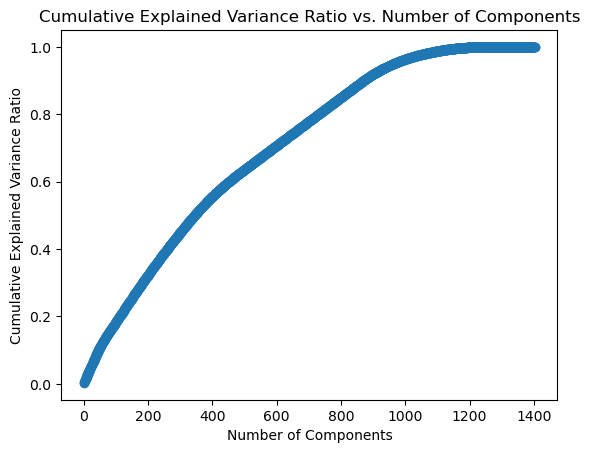

In [65]:
# plot cumulative explained variance ratio
plt.plot(range(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio vs. Number of Components')
plt.show()

In [66]:
# find the number of components that fall within 80% to 90% cumulative explained variance
target_variance_range = (0.80, 0.90)
target_components = np.where((explained_variance_ratio_cumulative >= target_variance_range[0]) &
                             (explained_variance_ratio_cumulative <= target_variance_range[1]))[0][0] + 1

print("Ideal number of components within 80% to 90% variance range:", target_components)

Ideal number of components within 80% to 90% variance range: 730


Out of the 1404 columns in the dataframe, only 730 will be used to build the model justified by PCA. 

### Data Splitting

In [67]:
# create a copy of df
ca_df = encoded_standardized.copy()

In [68]:
# split the dataset to predict whether death was intentional 
X = ca_df
y = force_df #Intentional_Use_of_Force_(Developing)is stored in its own df 

# split data into 60/40 split creating a temp set to store the validation and test
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)

# split reaming data from temp ste into test and validation 50/50 split 
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# scale the train & test set
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_valid_scaled = scaler.transform(X_valid)

# Apply PCA with 730 components
n_components = 730
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)
X_valid_pca = pca.transform(X_valid_scaled)


# print the dimensions of X_train_pca and X_test_pca
print("Dimensions of X_train_pca:", X_train_pca.shape)
print("Dimensions of X_test_pca:", X_test_pca.shape)
print("Dimensions of X_valid_pca:", X_valid_pca.shape)

Dimensions of X_train_pca: (2728, 730)
Dimensions of X_test_pca: (910, 730)
Dimensions of X_valid_pca: (910, 730)


In [97]:
original_feature_names = pca_df.columns
# create df for PCA-transformed data with original feature names from pca_df
selected_feature_indices = pca.components_.argsort()[:, ::-1][:, :n_components]
selected_feature_names = original_feature_names[selected_feature_indices[0]]
X_train_pca_df = pd.DataFrame(X_train_pca, columns=selected_feature_names)
X_test_pca_df = pd.DataFrame(X_test_pca, columns=selected_feature_names)

## Models

**Logistic Regression**

In [69]:
# # define models and parameters 
# model = LogisticRegression()
# solvers = ['newton-cg', 'lbfgs', 'liblinear']
# penalty = ['l2']
# c_values = [100, 10, 1.0, 0.1, 0.01]
# # define grid search
# grid = dict(solver=solvers,penalty=penalty,C=c_values)
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1,
#                            cv=cv, scoring='accuracy',error_score=0)
# grid_result = grid_search.fit(X_train_pca, y_train)
# # summarize results
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.982649 using {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.972753 (0.010127) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.969453 (0.009982) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.951366 (0.013115) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.975560 (0.010075) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.975316 (0.010407) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.954664 (0.013603) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.980570 (0.010286) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.980570 (0.010286) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.961998 (0.012353) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.982649 (0.009218) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.982649 (0.009218) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.967986 (0.011111) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
0.969211 (0.008743) wit

In [71]:
# fit logistic regression
logit_reg = LogisticRegression(penalty='l2', C=0.1, solver='newton-cg')
logit_reg.fit(X_train_pca, y_train)

LogisticRegression(C=0.1, solver='newton-cg')

In [100]:
print('intercept: ', logit_reg.intercept_[0])
pd.DataFrame({'coeff': logit_reg.coef_[0]}, index=X_train_pca_df.columns)

intercept:  -2.81129097878834


,coeff
"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No",0.925141
Subjects_gender_Female,-0.344773
Cause_of_death_Vehicle,-1.195873
Unique_ID,0.172496
"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Pending investigation",-0.067241
...,...
Location_of_death_(city)_Duarte,0.200585
"Agency_responsible_for_death_Hemet Police Department, San Bernardino County Sheriff's Office",-0.113591
Location_of_death_(city)_Douglas City,0.052811
Location_of_death_(city)_Dixie Valley,-0.169792


In [77]:
# confusion matrix for logistic regression
classificationSummary(y_train, logit_reg.predict(X_train_pca))
classificationSummary(y_test, logit_reg.predict(X_test_pca))

Confusion Matrix (Accuracy 0.9974)

       Prediction
Actual    0    1
     0 2005    6
     1    1  716
Confusion Matrix (Accuracy 0.9637)

       Prediction
Actual   0   1
     0 635  15
     1  18 242


**Random Forest**

In [80]:
# model = RandomForestClassifier()
# n_estimators = [ 100, 1000, 2000]
# max_features = ['sqrt', 'log2']
# # define grid search
# grid = dict(n_estimators=n_estimators,max_features=max_features)
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
# grid_result = grid_search.fit(X_train_pca, y_train)
# # summarize results
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.869627 using {'max_features': 'sqrt', 'n_estimators': 2000}
0.863642 (0.019022) with: {'max_features': 'sqrt', 'n_estimators': 100}
0.868283 (0.017329) with: {'max_features': 'sqrt', 'n_estimators': 1000}
0.869627 (0.017435) with: {'max_features': 'sqrt', 'n_estimators': 2000}
0.826858 (0.015279) with: {'max_features': 'log2', 'n_estimators': 100}
0.829061 (0.015789) with: {'max_features': 'log2', 'n_estimators': 1000}
0.825636 (0.015047) with: {'max_features': 'log2', 'n_estimators': 2000}


In [81]:
# fit random forest with the parameters
rf = RandomForestClassifier(n_estimators=2000, max_features='sqrt', random_state=1)
rf.fit(X_train_pca, y_train)

RandomForestClassifier(n_estimators=2000, random_state=1)

In [101]:
# variable importance plot
importances = rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf.estimators_], axis=0)
df = pd.DataFrame({'feature': X_train_pca_df.columns, 'importance': importances, 'std': std})
df = df.sort_values('importance')
print(df)

                                               feature  importance       std
634  Agency_responsible_for_death_Shafter Police De...    0.000525  0.001724
606  Agency_responsible_for_death_Rohnert Park Depa...    0.000529  0.001741
553                    Location_of_death_(city)_Santee    0.000543  0.001833
437               Location_of_death_(city)_Lemon Grove    0.000544  0.001764
482  Agency_responsible_for_death_Riverside County ...    0.000546  0.001685
..                                                 ...         ...       ...
54   Agency_responsible_for_death_Oakland Police De...    0.013569  0.018983
56   Agency_responsible_for_death_Richmond Police D...    0.015460  0.024433
49   Agency_responsible_for_death_Dinuba Police Dep...    0.021025  0.030631
0    Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...    0.023107  0.031345
2                               Cause_of_death_Vehicle    0.042384  0.047746

[730 rows x 3 columns]


In [84]:
# confusion matrix for Random Forest
classificationSummary(y_train, rf.predict(X_train_pca))
classificationSummary(y_test, rf.predict(X_test_pca))

Confusion Matrix (Accuracy 1.0000)

       Prediction
Actual    0    1
     0 2011    0
     1    0  717
Confusion Matrix (Accuracy 0.8396)

       Prediction
Actual   0   1
     0 634  16
     1 130 130


**Neural Network**

In [104]:
# fit neural network
clf = MLPClassifier(hidden_layer_sizes=(3), activation='logistic', solver='lbfgs',random_state=1, max_iter=1000)
clf.fit(X_train_pca,y_train)

MLPClassifier(activation='logistic', hidden_layer_sizes=3, max_iter=1000,
              random_state=1, solver='lbfgs')

In [105]:
# network structure
print('Intercepts')
print(clf.intercepts_)
print('Weights')
print(clf.coefs_)

Intercepts
[array([ 5.56134107,  1.78143346, -0.15510743]), array([13.06438518])]
Weights
[array([[ -4.08913035, -26.4627158 ,  -1.42003793],
       [  0.97887817,   9.45884649,   0.63721857],
       [  6.41125375,  30.8750038 ,   2.78477826],
       ...,
       [  0.12877781,  -0.13726186,  -0.18691576],
       [  1.53036862,   1.54413615,   0.44972613],
       [ -0.53315679,  -0.97254141,  -0.15044752]]), array([[-17.2326293 ],
       [-13.82059122],
       [-19.55482094]])]


In [107]:
# confusion matrix for neural network
classificationSummary(y_train, clf.predict(X_train_pca))
classificationSummary(y_test, clf.predict(X_test_pca))

Confusion Matrix (Accuracy 0.9996)

       Prediction
Actual    0    1
     0 2011    0
     1    1  716
Confusion Matrix (Accuracy 0.9374)

       Prediction
Actual   0   1
     0 619  31
     1  26 234


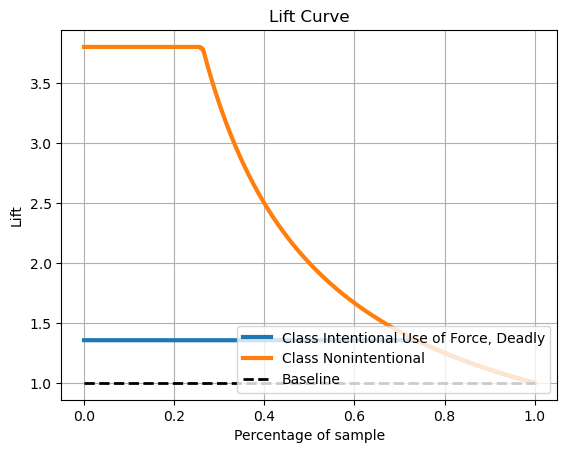

In [109]:
# define predicted with the probabilities from the model
predicted = logit_reg.predict_proba(X_train_pca)

#plot the predicted and initial values.
skplt.metrics.plot_lift_curve(y_train, predicted)
plt.show()